### Read the following instructions carefully.

1) Label your homework solutions with your last name, such as Exam1_Basnet.

2) Deliverables: You need to submit 2 solution files + the image file you used.
* ipython notebook file with all of your codes
* HTML file of your ipython notebook file.
*  <font color='red'> PDF file of the solution is not required. </font> 

3) To submit your exam solutions, go to our course in Canvas --> Assignments --> Exam 2 --> Submit Assignment --> Click "Choose File" --> choose the HTML file you saved --> Click another file--> choose ipynb file. Once you submit, download and check to ensure that you have submitted the correct files.


4) You can use this ipynb file to start your solution. 


5) This Exam is graded only by your Instructors.

<font color='red'> WARNING: Disclosure of this assignment and assignment answers to anybody or any website is a contributory infringement of academic dishonesty at ISU. Do not share or post course materials without the express written consent of the copyright holder and instructor. The class will follow Iowa State University’s policy on academic dishonesty. Anyone suspected of academic dishonesty will be reported to the Dean of Students Office.</font>


Data set link: https://www.kaggle.com/datasets/jonathanbesomi/superheroes-nlp-dataset?resource=download

### Problem 1. 
Upload the superheroes.csv data set and do the following.  
* Part 1: EDA
  - Remove the columns listed in cols_remove below. This will remove any columns that are not needed for the analysis.
  - Remove the rows where the history_text column is missing values. This will remove any rows that do not have a value for the history_text column.
  - The column 'name' should be missing one value. Make up a superhero name (such as "Nebula Fury") and use it to fill this one missing value in the name column.
  - Every column whose name starts with 'has' is binary with values of 0.0 or 1.0. For all these binary variables, count the values and display how many 1s and 0s they have. Fill their null values by 1 if they have more 1s than 0s. Fill them with 0s if they have more 0s than 1s.
  - Finally, clean the overall_score (shows as an object in the data) as follows. Remove the symbols '∞' and '-' that is in this column with np. nan values and then replace them with the average of the other overall_score values.

After these steps, every variable should be numerical except name, history_text, and superpowers.


* Part 2 Modeling: 
  - Use overall_score as a target and the rest of the numerical variables as features to create a multiple linear regression model using three models of your choice. Make sure to select an appropriate number of features using the method of your choice. Use the metrics Adjusted R-squared and RMSE for the test and train data sets. Report your best model.
 

Upload the superheroes.csv data set and do the following. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import json
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', 20)

In [2]:
# Load the config file
with open('config.json', 'r') as f:
    config = json.load(f)

data_loc = config["data_loc"]
file_name = "superheroes.csv"

In [3]:
# Load dataset, print its dimensions and look at a sample
superh_df = pd.read_csv(data_loc + file_name)
rows, columns = superh_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
superh_df.head(5)

The dataset contains 1,450 rows and 81 columns


,name,real_name,full_name,overall_score,history_text,powers_text,intelligence_score,strength_score,speed_score,durability_score,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,3-D Man,"Delroy Garrett, Jr.","Delroy Garrett, Jr.",6,"Delroy Garrett, Jr. grew up to become a track ...",NaN,85,30,60,60,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,514A (Gotham),Bruce Wayne,NaN,10,He was one of the many prisoners of Indian Hil...,NaN,100,20,30,50,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,A-Bomb,Richard Milhouse Jones,Richard Milhouse Jones,20,"Richard ""Rick"" Jones was orphaned at a young ...","On rare occasions, and through unusual circu...",80,100,80,100,...,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0
3,Aa,Aa,NaN,12,Aa is one of the more passive members of the P...,NaN,80,50,55,45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Aaron Cash,Aaron Cash,Aaron Cash,5,Aaron Cash is the head of security at Arkham A...,NaN,80,10,25,40,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Part 1: EDA
  - Remove the columns listed in cols_remove below. This will remove any columns that are not needed for the analysis.


In [4]:
cols_remove = ['real_name', 'full_name', 'powers_text', 'alter_egos', 'aliases',
                'place_of_birth','first_appearance', 'creator', 'alignment', 'occupation',
                'base', 'teams', 'relatives','gender', 'type_race','height', 'weight',
                'eye_color', 'hair_color', 'skin_color', 'img']

In [5]:
# Droping requested columns
problem1_df = superh_df.drop(columns=cols_remove)
rows, columns = problem1_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")

The dataset contains 1,450 rows and 60 columns


21 columns were dropped.

  - Remove the rows where the history_text column is missing values. This will remove any rows that do not have a value for the history_text column.

In [6]:
# Dropping null values in the history_text and reseting index
problem1_df.dropna(subset=['history_text'], inplace=True)
problem1_df = problem1_df.reset_index(drop=True)
rows, columns = problem1_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")

The dataset contains 1,360 rows and 60 columns


In [7]:
# How many columns were dropped in the above operation?
1450 - 1360

90

90 observations were dropped.

  - The column 'name' should be missing one value. Make up a superhero name (such as "Nebula Fury") and use it to fill this one missing value in the name column.

In [8]:
# Exploring name column
problem1_df[problem1_df['name'].isna()]

,name,overall_score,history_text,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
266,NaN,-,Dmitri Smerdyakov was the illegitimate son of ...,0,0,0,0,0,0,[],...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
problem1_df.iloc[266]

name                                                                              NaN
overall_score                                                                       -
history_text                        Dmitri Smerdyakov was the illegitimate son of ...
intelligence_score                                                                  0
strength_score                                                                      0
speed_score                                                                         0
durability_score                                                                    0
power_score                                                                         0
combat_score                                                                        0
superpowers                                                                        []
has_electrokinesis                                                                NaN
has_energy_constructs                                 

In [10]:
# Giving a name to the super hero
problem1_df.loc[266, 'name'] = "Monkey D. Luffy"
problem1_df.loc[266, 'name']

'Monkey D. Luffy'

The name I gave for this super hero was `Monkey D. Luffy`, the one who's going to be the pirate king, in reference to the One Piece anime.

  - Every column whose name starts with 'has' is binary with values of 0.0 or 1.0. For all these binary variables, count the values and display how many 1s and 0s they have. Fill their null values by 1 if they have more 1s than 0s. Fill them with 0s if they have more 0s than 1s.

In [11]:
# Collect binary features
prefix = "has"
binary_var = [column for column in problem1_df.columns if column.startswith(prefix)]
print(f"We have {len(binary_var)} binary features.")

# Get the ones and zeros counts
counts_list = []
for col in binary_var:
    sum_ones = (problem1_df[col] == 1).sum()
    sum_zeros = (problem1_df[col] == 0).sum()
    sum_nulls = problem1_df[col].isnull().sum()

    counts_list.append({
        "features": col,
        "ones": sum_ones,
        "zeros": sum_zeros,
        "nulls": sum_nulls
    })

    if sum_ones > sum_zeros:
        problem1_df[col].fillna(1.0, inplace=True)
    else:
        problem1_df[col].fillna(0.0, inplace=True)

binary_var_count = pd.DataFrame(counts_list)
binary_var_count['fill_na'] = np.where(binary_var_count['ones'] > binary_var_count['zeros'], 1, 0)
binary_var_count

We have 50 binary features.


,features,ones,zeros,nulls,fill_na
0,has_electrokinesis,117,1182,61,0
1,has_energy_constructs,94,1205,61,0
2,has_mind_control_resistance,95,1204,61,0
3,has_matter_manipulation,61,1238,61,0
4,has_telepathy_resistance,105,1194,61,0
5,has_mind_control,104,1195,61,0
6,has_enhanced_hearing,172,1127,61,0
7,has_dimensional_travel,97,1202,61,0
8,has_element_control,144,1155,61,0
9,has_size_changing,114,1185,61,0


In [12]:
print(f"Null values ramaning in the binary columns {problem1_df[binary_var].isnull().sum().sum()}.")

Null values ramaning in the binary columns 0.



  - Finally, clean the overall_score (shows as an object in the data) as follows. Remove the symbols '∞' and '-' that is in this column with np. nan values and then replace them with the average of the other overall_score values.

In [13]:
problem1_df.head(1)

,name,overall_score,history_text,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,3-D Man,6,"Delroy Garrett, Jr. grew up to become a track ...",85,30,60,60,40,70,"['Super Speed', 'Super Strength']",...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [14]:
problem1_df[problem1_df['overall_score'] == '∞'].shape

(12, 60)

In [15]:
problem1_df[problem1_df['overall_score'] == '-'].shape

(99, 60)

In [16]:
# Replace specials characters with np.nan
problem1_df['overall_score'] = problem1_df['overall_score'].replace(['∞', '-'], np.nan)

print(problem1_df[problem1_df['overall_score'] == '∞'].shape)
print(problem1_df[problem1_df['overall_score'] == '-'].shape)

(0, 60)
(0, 60)


In [17]:
# Replace np.nan with the average values
problem1_df['overall_score'] = pd.to_numeric(problem1_df['overall_score'], errors='coerce')
problem1_df['overall_score'].fillna(problem1_df['overall_score'].mean(), inplace=True)

print(problem1_df[problem1_df['overall_score'].isna()].shape)

(0, 60)



After these steps, every variable should be numerical except name, history_text, and superpowers.

In [18]:
cat_columns = problem1_df.select_dtypes(include=['object', 'category']).columns
print(cat_columns)

Index(['name', 'history_text', 'superpowers'], dtype='object')


## Part 2 Modeling: 
  - Use overall_score as a target and the rest of the numerical variables as features to create a multiple linear regression model using three models of your choice. Make sure to select an appropriate number of features using the method of your choice. Use the metrics Adjusted R-squared and RMSE for the test and train data sets. Report your best model.

In [19]:
# Data prep for modeling
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# Modeling
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.metrics import mean_squared_error

#### Define input and target features and spltting data into train and test

In [20]:
# Define input and target features
X = problem1_df.drop(columns=['name', 'history_text', 'superpowers', 'overall_score'])
y = problem1_df['overall_score']

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Scale dataset given that we need to only use multiple linear regression models
X_train_scaled = scaler.fit_transform(X_train)
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)

X_test_scaled = scaler.transform(X_test)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)


# Print the dimensions of the scaled data
print(f'Training set dimensions: {X_train_scaled.shape}, {y_train.shape}')
print(f'Testing set dimensions: {X_test_scaled.shape}, {y_test.shape}')

Training set dimensions: (1088, 56), (1088,)
Testing set dimensions: (272, 56), (272,)


* *Models to be considered:* 
    - Multiple Linear Regression with all features
    - Ridge Regression with Recursive Feature Elimination (RFE)
    - Lasso Regression with Feature Selection Based on Correlation Analysis

In [21]:
# Performance
performance_df=pd.DataFrame()

# Predictions
results_train = pd.DataFrame({'True Results': y_train})
results_test = pd.DataFrame({'True Results': y_test})

#### Multiple Linear Regression

In [22]:
# Model Name
current_model = "LinearRegression"
current_model_short = "MLR"

# Use the scaled data for model training and evaluation
X_train_best = X_train_scaled.copy()
X_test_best = X_test_scaled.copy()

# Initialize and fit the Linear Regression model
linear_regression = LinearRegression()
linear_regression.fit(X_train_best, y_train)

# Evaluate Model
rsquared_train = linear_regression.score(X_train_best, y_train)
rsquared_test = linear_regression.score(X_test_best, y_test)
rmse_train = np.sqrt(mean_squared_error(y_train, linear_regression.predict(X_train_best)))
rmse_test = np.sqrt(mean_squared_error(y_test, linear_regression.predict(X_test_best)))

# Calculate Adjusted R-squared
n_train = X_train_best.shape[0]  # Number of observations in training set
k_train = X_train_best.shape[1]  # Number of features in training set
adjusted_rsquared_train = 1 - (1 - rsquared_train) * (n_train - 1) / (n_train - k_train - 1)

n_test = X_test_best.shape[0]  # Number of observations in test set
k_test = X_test_best.shape[1]  # Number of features in test set
adjusted_rsquared_test = 1 - (1 - rsquared_test) * (n_test - 1) / (n_test - k_test - 1)

# Predict on training and testing sets
results_train = pd.DataFrame({current_model_short + "_pred": linear_regression.predict(X_train_best)})
results_test = pd.DataFrame({current_model_short + "_pred": linear_regression.predict(X_test_best)})

# Create entry for this model
current_metrics = pd.DataFrame({
    'Model': current_model,
    'Test Adjusted R²': [round(adjusted_rsquared_test, 4)],
    'Train Adjusted R²': [round(adjusted_rsquared_train, 4)],
    'Test RMSE': [round(rmse_test, 1)],
    'Train RMSE': [round(rmse_train, 1)],
    'Number of Train Features': [X_train_best.shape[1]],
    'Train Features': [list(X_train_best.columns)]
})

# Append metrics to performance DataFrame
performance_df = pd.concat([performance_df, current_metrics], ignore_index=True)
performance_df.head()


,Model,Test Adjusted R²,Train Adjusted R²,Test RMSE,Train RMSE,Number of Train Features,Train Features
0,LinearRegression,0.4601,0.5378,13.8,13.9,56,"[intelligence_score, strength_score, speed_sco..."


As we can see from the above dataset, the Multiple Linear Regressor model is performing poorly, as indicated by the evaluation metrics. Next, I will try to reduce the model complexity by performing feature selection using Ridge Regression with RFE and to indentify the important features.

#### Ridge Regression wtih RFE

In [23]:
# Model Name
current_model = "RidgeRegressionRFE"
current_model_short = "RidgeRFE"

# Feature Selection using RFE
rfe_selector = RFE(estimator=LinearRegression(), n_features_to_select=20)
X_train_rfe = rfe_selector.fit_transform(X_train_scaled, y_train)
X_train_rfe = pd.DataFrame(X_train_rfe, columns=X_train.columns[rfe_selector.support_])

X_test_rfe = rfe_selector.transform(X_test_scaled)
X_test_rfe = pd.DataFrame(X_test_rfe, columns=X_test.columns[rfe_selector.support_])

# Train Ridge Regression
ridge = Ridge(alpha=.1)
ridge.fit(X_train_rfe, y_train)

# Evaluate Model
rsquared_train = ridge.score(X_train_rfe, y_train)
rsquared_test = ridge.score(X_test_rfe, y_test)
rmse_train = np.sqrt(mean_squared_error(y_train, ridge.predict(X_train_rfe)))
rmse_test = np.sqrt(mean_squared_error(y_test, ridge.predict(X_test_rfe)))

# Calculate Adjusted R-squared
n_train = X_train_rfe.shape[0]  # Number of observations in training set
k_train = X_test_rfe.shape[1]  # Number of features in training set
adjusted_rsquared_train = 1 - (1 - rsquared_train) * (n_train - 1) / (n_train - k_train - 1)

n_test = X_test_rfe.shape[0]  # Number of observations in test set
k_test = X_test_rfe.shape[1]  # Number of features in test set
adjusted_rsquared_test = 1 - (1 - rsquared_test) * (n_test - 1) / (n_test - k_test - 1)

# Predict on training and testing sets
results_train = pd.DataFrame({current_model_short + "_pred": ridge.predict(X_train_rfe)})
results_test = pd.DataFrame({current_model_short + "_pred": ridge.predict(X_test_rfe)})

# Create entry for this model
current_metrics = pd.DataFrame({
    'Model': current_model,
    'Test Adjusted R²': [round(adjusted_rsquared_test, 4)],
    'Train Adjusted R²': [round(adjusted_rsquared_train, 4)],
    'Test RMSE': [round(rmse_test, 1)],
    'Train RMSE': [round(rmse_train, 1)],
    'Number of Train Features': [X_train_rfe.shape[1]],
    'Train Features': [list(X_train_rfe.columns)]
})

# Append metrics to performance DataFrame
performance_df = pd.concat([performance_df, current_metrics], ignore_index=True)
performance_df.head()

,Model,Test Adjusted R²,Train Adjusted R²,Test RMSE,Train RMSE,Number of Train Features,Train Features
0,LinearRegression,0.4601,0.5378,13.8,13.9,56,"[intelligence_score, strength_score, speed_sco..."
1,RidgeRegressionRFE,0.5299,0.5330,13.9,14.2,20,"[strength_score, speed_score, power_score, has..."


As we can see from the performance dataset above, feature selection has improved model performance on the test set with reduced feature set (20 features), leading to a more balanced model but still higher RMSE (13.9). This is the best model so far with a Adjusted R² of .5299 on the test set, which isn't good, but definitly better than the first trial. 

Moving forward to the next model, I will train the Lasso Regression with correlation analysis next.

#### Lasso Regression with Correlation Analysis

In [24]:
# Model Name
current_model = "LassoRegression"
current_model_short = "Lasso"

# Feature Selection based on correlation
correlation_threshold = 0.02
correlations = X_train_scaled.corrwith(y_train).abs()
selected_features = correlations[correlations > correlation_threshold].index

X_train_corr = X_train_scaled[selected_features]
X_test_corr = X_test_scaled[selected_features]

# Train Lasso Regression
lasso = Lasso(alpha=.1)
lasso.fit(X_train_corr, y_train)

# Evaluate Model
rsquared_train = lasso.score(X_train_corr, y_train)
rsquared_test = lasso.score(X_test_corr, y_test)
rmse_train = np.sqrt(mean_squared_error(y_train, lasso.predict(X_train_corr)))
rmse_test = np.sqrt(mean_squared_error(y_test, lasso.predict(X_test_corr)))

# Calculate Adjusted R-squared
n_train = X_train_corr.shape[0]  # Number of observations in training set
k_train = X_test_corr.shape[1]  # Number of features in training set
adjusted_rsquared_train = 1 - (1 - rsquared_train) * (n_train - 1) / (n_train - k_train - 1)

n_test = X_test_rfe.shape[0]  # Number of observations in test set
k_test = X_test_rfe.shape[1]  # Number of features in test set
adjusted_rsquared_test = 1 - (1 - rsquared_test) * (n_test - 1) / (n_test - k_test - 1)

# Predict on training and testing sets
results_train = pd.DataFrame({current_model_short + "_pred": lasso.predict(X_train_corr)})
results_test = pd.DataFrame({current_model_short + "_pred": lasso.predict(X_test_corr)})

# Create entry for this model
current_metrics = pd.DataFrame({
    'Model': current_model,
    'Test Adjusted R²': [round(adjusted_rsquared_test, 4)],
    'Train Adjusted R²': [round(adjusted_rsquared_train, 4)],
    'Test RMSE': [round(rmse_test, 1)],
    'Train RMSE': [round(rmse_train, 1)],
    'Number of Train Features': [X_train_corr.shape[1]],
    'Train Features': [list(X_train_corr.columns)]
})

# Append metrics to performance DataFrame
performance_df = pd.concat([performance_df, current_metrics], ignore_index=True)
performance_df


,Model,Test Adjusted R²,Train Adjusted R²,Test RMSE,Train RMSE,Number of Train Features,Train Features
0,LinearRegression,0.4601,0.5378,13.8,13.9,56,"[intelligence_score, strength_score, speed_sco..."
1,RidgeRegressionRFE,0.5299,0.5330,13.9,14.2,20,"[strength_score, speed_score, power_score, has..."
2,LassoRegression,0.5332,0.4757,13.8,15.0,27,"[strength_score, has_mind_control_resistance, ..."


Lasso Regression had the best performance, with Test Adjusted R² of 0.5332 and lowest Test RMSE (13.8), conting with 27 features and maintaining generalization.

#### Conclusion 
Lasso Regression stood out as the best balance between model complexity and predictive performance.

### Problem 2. 
Continuing with the features you selected in problem 1, do the following.
* Part 1 Vectorizer:
  - Use the count vectorizer of your choice to develop the numerical features from the history_text column. This will create a numerical representation of the history_text column that can be used as features in the model.
  - Concatenate the numerical features from the history_text column with the selected numerical features from problem 
  - Retrain a linear regression model with test-train (25%, 75%) rule and report your $R^2$ and RMSE for the test set. 
* Part 2 Similarity:
  - Using the cosine similarity and Jaccard similarity, what are the most similar superhero names with your made-up superhero name for the missing superhero (such as "Nebula Fury").

#### Part 1 Vectorizer:
  - Use the count vectorizer of your choice to develop the numerical features from the history_text column. This will create a numerical representation of the history_text column that can be used as features in the model.
  - Concatenate the numerical features from the history_text column with the selected numerical features from problem 

In [25]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [26]:
# Fit and transform the text data
count_vectorizer = CountVectorizer()
count_matrix = count_vectorizer.fit_transform(problem1_df['history_text'])

# Get the feature names
feature_names = count_vectorizer.get_feature_names_out()

# Convert the matrix to DF and add 'cv_' prefix to each column
count_df = pd.DataFrame(count_matrix.toarray(), columns=feature_names)
count_df.columns = ['cv_' + col for col in count_df.columns]

# Merge the CountVectorizer df with the original df
problem2_df = pd.concat([problem1_df, count_df], axis=1)

# Display
rows, columns = problem2_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
problem2_df.head(1)

The dataset contains 1,360 rows and 29133 columns


,name,overall_score,history_text,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,...,cv_الساحر,cv_الغول,cv_تاليا,cv_رأس,cv_رعتكو,cv_سراب,cv_نيسا,cv_アーカード,cv_拳王,cv_駄犬
0,3-D Man,6.0,"Delroy Garrett, Jr. grew up to become a track ...",85,30,60,60,40,70,"['Super Speed', 'Super Strength']",...,0,0,0,0,0,0,0,0,0,0


 - Retrain a linear regression model with test-train (25%, 75%) rule and report your $R^2$ and RMSE for the test set. 

#### Multiple Linear Regression

#### Correlaiton Analysis

At this stage, the dataset contains 29,129 columns and only 1,360 records. Here, we have more columns than records, which makes it impossible to calculate a meaningful Adjusted R-squared. In order to make this to work, I performed a correlation analysis to pre-select input features by setting a correlation threshold. Features that are not sufficiently correlated with the target variable will be excluded in this step to reduce the feature set and streamline the selection process.

In [27]:
# Define threshold
threshold = .25

# Get the feature columns
features = problem2_df.drop(columns=['name', 'history_text', 'superpowers', 'overall_score'])

# Compute correlations between each feature and the target variable
correlations = features.corrwith(problem2_df['overall_score'])

# Apply threshold
correlations = correlations[correlations.abs() > threshold]
correlated_features = (correlations.keys()).to_list()

# Display
print("Number of remaining columns: ", len(correlations))
print(correlations)

Number of remaining columns:  251
strength_score                 0.376325
speed_score                    0.367550
durability_score               0.322875
power_score                    0.295915
has_mind_control_resistance    0.351506
                                 ...   
cv_wrestle                     0.268794
cv_zann                        0.277851
cv_zead                        0.254562
cv_zennon                      0.277851
cv_ţepeş                       0.254562
Length: 251, dtype: float64


Selected Top Features:  Index(['has_reality_warping', 'has_immortality', 'has_matter_manipulation',
       'has_dimensional_travel', 'has_energy_manipulation',
       'has_teleportation', 'has_mind_control', 'has_telekinesis',
       'strength_score', 'speed_score'],
      dtype='object')


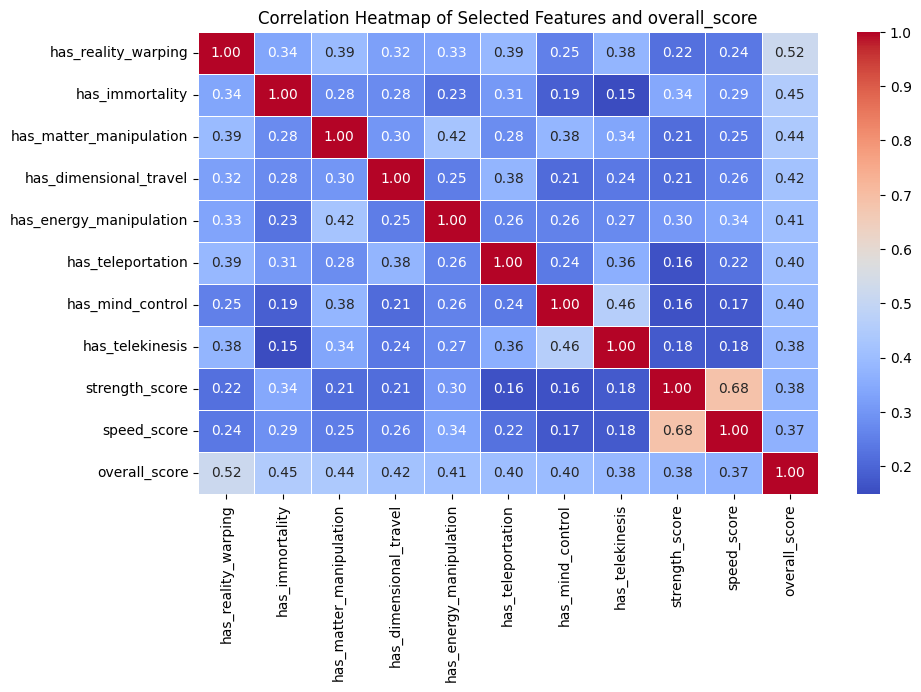

In [28]:
# Select top n features with highest absolute correlation
corr_top_features = correlations.abs().sort_values(ascending=False).head(10).index
print("Selected Top Features: ", corr_top_features)

# Create a new DF with the top features and the target
selected_data = problem2_df[corr_top_features.to_list() + ['overall_score']]
corr_matrix = selected_data.corr()

# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Heatmap of Selected Features and overall_score")
plt.show()

#### Define input and target features and spltting data into train and test

In [29]:
# Define input and target features
X = problem2_df[correlated_features]
y = problem2_df['overall_score']

# Split data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Scale dataset given that we need to only use multiple linear regression models
X_train_scaled = scaler.fit_transform(X_train)
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)

X_test_scaled = scaler.transform(X_test)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

print(f'Training set dimensions: {X_train_scaled.shape}, {y_train.shape}')
print(f'Testing set dimensions: {X_test_scaled.shape}, {y_test.shape}')

Training set dimensions: (1020, 251), (1020,)
Testing set dimensions: (340, 251), (340,)


In [30]:
# Performance
performance_df=pd.DataFrame()

# Predictions
results_train = pd.DataFrame({'True Results': y_train})
results_test = pd.DataFrame({'True Results': y_test})

#### Multiple Linear Regression

In [31]:
# Model Name
current_model = "LinearRegression"
current_model_short = "MLR"

# Select top features
X_train_best = X_train_scaled[correlated_features]
X_test_best = X_test_scaled[correlated_features]

# Initialize and fit the Linear Regression model
linear_regression = LinearRegression()
linear_regression.fit(X_train_best, y_train)

# Evaluate the model
rsquared_train = linear_regression.score(X_train_best, y_train)
rsquared_test = linear_regression.score(X_test_best, y_test)
rmse_train = np.sqrt(mean_squared_error(y_train, linear_regression.predict(X_train_best)))
rmse_test = np.sqrt(mean_squared_error(y_test, linear_regression.predict(X_test_best)))

# Calculate Adjusted R-squared
n_train = X_train_best.shape[0]
k_train = X_train_best.shape[1]
adjusted_rsquared_train = 1 - (1 - rsquared_train) * (n_train - 1) / (n_train - k_train - 1)

n_test = X_test_best.shape[0]
k_test = X_test_best.shape[1]
adjusted_rsquared_test = 1 - (1 - rsquared_test) * (n_test - 1) / (n_test - k_test - 1)

# Predict on training and testing sets
results_train = pd.DataFrame({current_model_short + "_pred": linear_regression.predict(X_train_best)})
results_test = pd.DataFrame({current_model_short + "_pred": linear_regression.predict(X_test_best)})

# Create entry for this model
current_metrics = pd.DataFrame({
    'Model': current_model,
    'Test Adjusted R²': [round(adjusted_rsquared_test, 4)],
    'Train Adjusted R²': [round(adjusted_rsquared_train, 4)],
    'Test RMSE': [round(rmse_test, 1)],
    'Train RMSE': [round(rmse_train, 1)],
    'Number of Train Features': [X_train_best.shape[1]],
    'Train Features': [list(X_train_best.columns)]
})

# Append metrics to performance DataFrame
performance_df = pd.concat([performance_df, current_metrics], ignore_index=True)
performance_df

,Model,Test Adjusted R²,Train Adjusted R²,Test RMSE,Train RMSE,Number of Train Features,Train Features
0,LinearRegression,-1.1002,0.6116,14.5,11.6,251,"[strength_score, speed_score, durability_score..."


The above model had the best performance on the train set so far and the worst perfmance on the test set. This is a clear indication of overfitting. Lasso and Ridge techiniques will likely improve performance of the model.

#### Ridge Regression wtih RFE

In [32]:
# Model Name
current_model = "RidgeRegressionRFE"
current_model_short = "RidgeRFE"

# Feature Selection using RFE
rfe_selector = RFE(estimator=LinearRegression(), n_features_to_select=20)
# Train
X_train_rfe = rfe_selector.fit_transform(X_train_scaled, y_train)
X_train_rfe = pd.DataFrame(X_train_rfe, columns=X_train.columns[rfe_selector.support_])
# Test
X_test_rfe = rfe_selector.transform(X_test_scaled)
X_test_rfe = pd.DataFrame(X_test_rfe, columns=X_test.columns[rfe_selector.support_])

# Train Ridge Regression
ridge = Ridge(alpha=.1)
ridge.fit(X_train_rfe, y_train)

# Evaluate Model
rsquared_train = ridge.score(X_train_rfe, y_train)
rsquared_test = ridge.score(X_test_rfe, y_test)
rmse_train = np.sqrt(mean_squared_error(y_train, ridge.predict(X_train_rfe)))
rmse_test = np.sqrt(mean_squared_error(y_test, ridge.predict(X_test_rfe)))

# Calculate Adjusted R-squared
n_train = X_train_rfe.shape[0]  # Number of observations in training set
k_train = X_test_rfe.shape[1]  # Number of features in training set
adjusted_rsquared_train = 1 - (1 - rsquared_train) * (n_train - 1) / (n_train - k_train - 1)

n_test = X_test_rfe.shape[0]  # Number of observations in test set
k_test = X_test_rfe.shape[1]  # Number of features in test set
adjusted_rsquared_test = 1 - (1 - rsquared_test) * (n_test - 1) / (n_test - k_test - 1)

# Predict on training and testing sets
results_train = pd.DataFrame({current_model_short + "_pred": ridge.predict(X_train_rfe)})
results_test = pd.DataFrame({current_model_short + "_pred": ridge.predict(X_test_rfe)})

# Create entry for this model
current_metrics = pd.DataFrame({
    'Model': current_model,
    'Test Adjusted R²': [round(adjusted_rsquared_test, 4)],
    'Train Adjusted R²': [round(adjusted_rsquared_train, 4)],
    'Test RMSE': [round(rmse_test, 1)],
    'Train RMSE': [round(rmse_train, 1)],
    'Number of Train Features': [X_train_rfe.shape[1]],
    'Train Features': [list(X_train_rfe.columns)]
})

# Append metrics to performance DataFrame
performance_df = pd.concat([performance_df, current_metrics], ignore_index=True)
performance_df.head()

,Model,Test Adjusted R²,Train Adjusted R²,Test RMSE,Train RMSE,Number of Train Features,Train Features
0,LinearRegression,-1.1002,0.6116,14.5,11.6,251,"[strength_score, speed_score, durability_score..."
1,RidgeRegressionRFE,-0.0642,0.1835,19.7,19.1,20,"[cv_azmodus, cv_aztar, cv_beltane, cv_brujería..."


The Ridge model did decreased the ovefitting when compared to the first model, but the issue still exist. Let's try the Lasso techinique next.

#### Lasso Regression with Correlation Analysis

In [33]:
# Model Name
current_model = "LassoRegression"
current_model_short = "Lasso"

# Feature Selection based on correlation
correlation_threshold = 0.02
correlations = X_train_scaled.corrwith(y_train).abs()
selected_features = correlations[correlations > correlation_threshold].index

X_train_corr = X_train_scaled[selected_features]
X_test_corr = X_test_scaled[selected_features]

# Train Lasso Regression
lasso = Lasso(alpha=.1)
lasso.fit(X_train_corr, y_train)

# Evaluate Model
rsquared_train = lasso.score(X_train_corr, y_train)
rsquared_test = lasso.score(X_test_corr, y_test)
rmse_train = np.sqrt(mean_squared_error(y_train, lasso.predict(X_train_corr)))
rmse_test = np.sqrt(mean_squared_error(y_test, lasso.predict(X_test_corr)))

# Calculate Adjusted R-squared
n_train = X_train_corr.shape[0]  # Number of observations in training set
k_train = X_test_corr.shape[1]  # Number of features in training set
adjusted_rsquared_train = 1 - (1 - rsquared_train) * (n_train - 1) / (n_train - k_train - 1)

n_test = X_test_rfe.shape[0]  # Number of observations in test set
k_test = X_test_rfe.shape[1]  # Number of features in test set
adjusted_rsquared_test = 1 - (1 - rsquared_test) * (n_test - 1) / (n_test - k_test - 1)

# Predict on training and testing sets
results_train = pd.DataFrame({current_model_short + "_pred": lasso.predict(X_train_corr)})
results_test = pd.DataFrame({current_model_short + "_pred": lasso.predict(X_test_corr)})

# Create entry for this model
current_metrics = pd.DataFrame({
    'Model': current_model,
    'Test Adjusted R²': [round(adjusted_rsquared_test, 4)],
    'Train Adjusted R²': [round(adjusted_rsquared_train, 4)],
    'Test RMSE': [round(rmse_test, 1)],
    'Train RMSE': [round(rmse_train, 1)],
    'Number of Train Features': [X_train_corr.shape[1]],
    'Train Features': [list(X_train_corr.columns)]
})

# Append metrics to performance DataFrame
performance_df = pd.concat([performance_df, current_metrics], ignore_index=True)
performance_df

,Model,Test Adjusted R²,Train Adjusted R²,Test RMSE,Train RMSE,Number of Train Features,Train Features
0,LinearRegression,-1.1002,0.6116,14.5,11.6,251,"[strength_score, speed_score, durability_score..."
1,RidgeRegressionRFE,-0.0642,0.1835,19.7,19.1,20,"[cv_azmodus, cv_aztar, cv_beltane, cv_brujería..."
2,LassoRegression,0.5028,0.5675,13.5,13.8,35,"[has_mind_control, has_dimensional_travel, has..."


Lasso did it again! It had the best performance, with Test Adjusted R² of 0.5028 and lowest Test RMSE (13.5), conting with 35 features and maintaining generalization.

#### Conclusion 
Lasso Regression stood out as the best balance between model complexity and predictive performance.

### Part 2 Similarity:
  - Using the cosine similarity and Jaccard similarity, what are the most similar superhero names with your made-up superhero name for the missing superhero (such as "Nebula Fury").

In [34]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import jaccard_score
from sklearn.preprocessing import MultiLabelBinarizer

In [35]:
# My hero name
my_hero_name = "Monkey D. Luffy"

# All other heros
superhero_names = superh_df['name'].dropna().tolist()

vectorizer = TfidfVectorizer().fit_transform([my_hero_name] + superhero_names)
similarity_matrix = cosine_similarity(vectorizer[0:1], vectorizer[1:])
similarity_matrix

array([[0., 0., 0., ..., 0., 0., 0.]])

In [36]:
# Flatten the similarity matrix and get the top 5 most similar names
similarity_scores = similarity_matrix.flatten()
most_similar_indices = similarity_scores.argsort()[-5:][::-1]  # Get top 5 indices
most_similar_names_cosine = [superhero_names[i] for i in most_similar_indices]

print("Most similar superheros based on Cosine Similarity:", most_similar_names_cosine)
print("")

Most similar superheros based on Cosine Similarity: ['Hit-Monkey', 'Zzzax', 'Firelord', 'Firestorm (CW)', 'Firestorm II (CW)']



In [37]:
def jaccard_similarity(name1, name2):
    set1, set2 = set(name1.lower().split()), set(name2.lower().split())
    intersection = len(set1.intersection(set2))
    union = len(set1.union(set2))
    return intersection / union if union != 0 else 0

jaccard_scores = [jaccard_similarity(my_hero_name, name) for name in superhero_names]
most_similar_indices_jaccard = sorted(range(len(jaccard_scores)), key=lambda i: jaccard_scores[i], reverse=True)[:5]
most_similar_names_jaccard = [superhero_names[i] for i in most_similar_indices_jaccard]

print("Most similar superheros based on Jaccard Similarity:", most_similar_names_jaccard)


Most similar superheros based on Jaccard Similarity: ['3-D Man', '514A (Gotham)', 'A-Bomb', 'Aa', 'Aaron Cash']


### Problem 3. 
From the cleaned data from problem 1, pick the name, overall_score, and superpowers and do the following.
* Part 1 EDA for the Network:
  - The superpowers column lists the superpowers mostly as a list. You will create more rows of data by using the different superpowers (see the example below). This should create a data frame with more rows and only one value in the superpower column. What is the dimension of the dataset after this?
* Part 2 Network Graph:
  - Create a network graph with the name as a source and the (one) superpower as a target. Label the vertices with their respective labels. Add different colors for the source and the target, and change the size of the edge using the normalized overall_score. And change the size of the vertices by their degrees (scale if required).
(If this takes too long on your computer, you can use Pagerank to rank the superpowers and choose however many your computer can handle.)

From the cleaned data from problem 1, pick the name, overall_score, and superpowers and do the following.

In [38]:
problem3_df = problem1_df[['name', 'overall_score', 'superpowers']]
rows, columns = problem3_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
problem3_df.head(5)

The dataset contains 1,360 rows and 3 columns


,name,overall_score,superpowers
0,3-D Man,6.0,"['Super Speed', 'Super Strength']"
1,514A (Gotham),10.0,"['Durability', 'Reflexes', 'Super Strength']"
2,A-Bomb,20.0,"['Accelerated Healing', 'Agility', 'Berserk Mo..."
3,Aa,12.0,"['Energy Absorption', 'Energy Armor', 'Energy ..."
4,Aaron Cash,5.0,"['Weapon-based Powers', 'Weapons Master']"


### Part 1 EDA for the Network:
  - The superpowers column lists the superpowers mostly as a list. You will create more rows of data by using the different superpowers (see the example below). This should create a data frame with more rows and only one value in the superpower column. What is the dimension of the dataset after this?


In [39]:
# First row should look like this
pd.DataFrame({'name': ['3-D Man'], 'overall_score': [6.0], 'superpowers': [["'Super Speed'", "'Super Strength'"]]})

,name,overall_score,superpowers
0,3-D Man,6.0,"['Super Speed', 'Super Strength']"


In [40]:
# After you you do EDA for the network
pd.DataFrame({'name': ['3-D Man', '3-D Man'], 'overall_score': [6.0, 6.0], 'superpowers': ["'Super Speed'", "'Super Strength'"]})

,name,overall_score,superpowers
0,3-D Man,6.0,'Super Speed'
1,3-D Man,6.0,'Super Strength'


##### Apply transformation:

In [41]:
problem3_df['superpowers'] = problem3_df['superpowers'].apply(lambda x: eval(x))
problem3_df = problem3_df.explode('superpowers')
rows, columns = problem3_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
problem3_df.head(5)

The dataset contains 19,065 rows and 3 columns


,name,overall_score,superpowers
0,3-D Man,6.0,Super Speed
0,3-D Man,6.0,Super Strength
1,514A (Gotham),10.0,Durability
1,514A (Gotham),10.0,Reflexes
1,514A (Gotham),10.0,Super Strength


In [42]:
19065 - 1360

17705

This transformation added 17,705 observations to the dataset.

### Part 2 Network Graph:
  - Create a network graph with the name as a source and the (one) superpower as a target. Label the vertices with their respective labels. Add different colors for the source and the target, and change the size of the edge using the normalized overall_score. And change the size of the vertices by their degrees (scale if required).
(If this takes too long on your computer, you can use Pagerank to rank the superpowers and choose however many your computer can handle.)

In [43]:
import networkx as nx
import matplotlib.pyplot as plt
from sknetwork.data import Bunch 
from sknetwork.ranking import PageRank 
from scipy.sparse import csr_matrix
from sklearn.preprocessing import MinMaxScaler
import matplotlib.colors as mcolors

In [44]:
print(f"Unique count of name: {len(problem3_df['name'].unique())}")
print(f"Unique count of superpowers: {len(problem3_df['superpowers'].unique())}")

Unique count of name: 1360
Unique count of superpowers: 293


The dataset features 1,360 unique superhero names and 293 unique superpowers, creating a complex, high-cardinality network. To simplify the analysis, I used PageRank to identify the most influential superpowers within the network. Additionally, I established a superhero benchmark by considering only those with an overall score above the average, ensuring the focus remains on the most impactful figures in the superhero universe.

In [45]:
# Convert the data to a directed graph
G = nx.from_pandas_edgelist(problem3_df, 'name', 'superpowers', create_using=nx.DiGraph)

# Convert the NetworkX graph to a sparse CSR matrix
adjacency = csr_matrix(nx.to_scipy_sparse_array(G, dtype=None, weight='weight', format='csr'))
names = np.array(list(G.nodes()))
graph = Bunch()
graph.adjacency = adjacency
graph.names = names

# Apply the PageRank algorithm
pagerank = PageRank()
pagerank.fit(adjacency)
scores = pagerank.scores_
scores = [round(score, 3) for score in scores]

# Convert the PageRank scores to a DataFrame
pagerank_df = pd.DataFrame({'superpowers': names, 'PageRank': scores}).sort_values(by='PageRank', ascending=False).reset_index(drop=True)
pagerank_df.head()

,superpowers,PageRank
0,Super Strength,0.018
1,Agility,0.018
2,Weapons Master,0.017
3,Intelligence,0.017
4,Durability,0.016


In [46]:
# Select the top superpowers
top_names = pagerank_df['superpowers'].head(40).tolist()

# Filter data based on the top superpowers and overall_score
overall_score_mean = problem3_df['overall_score'].mean() 
filtered_df = problem3_df[(problem3_df['superpowers'].isin(top_names)) & (problem3_df['overall_score'] > overall_score_mean)]
filtered_df

,name,overall_score,superpowers
10,Abra Kadabra,29.0,Immortality
10,Abra Kadabra,29.0,Intelligence
10,Abra Kadabra,29.0,Longevity
10,Abra Kadabra,29.0,Magic
10,Abra Kadabra,29.0,Marksmanship
...,...,...,...
1336,Wotan,28.0,Intelligence
1336,Wotan,28.0,Longevity
1336,Wotan,28.0,Magic
1336,Wotan,28.0,Telepathy


In [47]:
print(f"Unique count of name: {len(filtered_df['name'].unique())}")
print(f"Unique count of superpowers: {len(filtered_df['superpowers'].unique())}")

Unique count of name: 102
Unique count of superpowers: 40


After applying the filters, the dataset was refined to include 102 superheroes and 40 common superpowers. With this streamlined set, we can proceed to visualize the network, highlighting the relationships between these key superheroes and their abilities.

In [48]:
# Normalize Overal Score
scaler = MinMaxScaler()
filtered_df['normalized_overall_score'] = scaler.fit_transform(filtered_df[['overall_score']])

# Build  the DiGraph
G = nx.DiGraph()

# Superhero Names
name = filtered_df['name'].unique()
G.add_nodes_from(name, node_type='name')

# Superhero superpowers
superpowers = filtered_df['superpowers'].unique()
G.add_nodes_from(superpowers, node_type='superpowers')

# Use nomilized overall score for thickness weight
for _, row in filtered_df.iterrows():
    G.add_edge(row['name'], row['superpowers'], weight=row['normalized_overall_score'])
name = {n for n in G.nodes if G.out_degree(n) > 0}
superpowers = {n for n in G.nodes if G.in_degree(n) > 0}

# Size of the node based on their degree
superpower_sizes = [G.in_degree(superpower) * 100 for superpower in superpowers]

In [49]:
## Graph config
cmap1 = plt.get_cmap('tab20b')
cmap2 = plt.get_cmap('tab20c')

colors = [mcolors.to_hex(cmap1(i)) for i in range(cmap1.N)] + [mcolors.to_hex(cmap2(i)) for i in range(8)]

distinct_colors = colors[:24]

color_names = [distinct_colors[i] for i in range(len(distinct_colors))]

holder_color_map = {holder: color_names[i % len(color_names)] for i, holder in enumerate(name)}

edge_colors = [holder_color_map[u] for u, v in G.edges()]

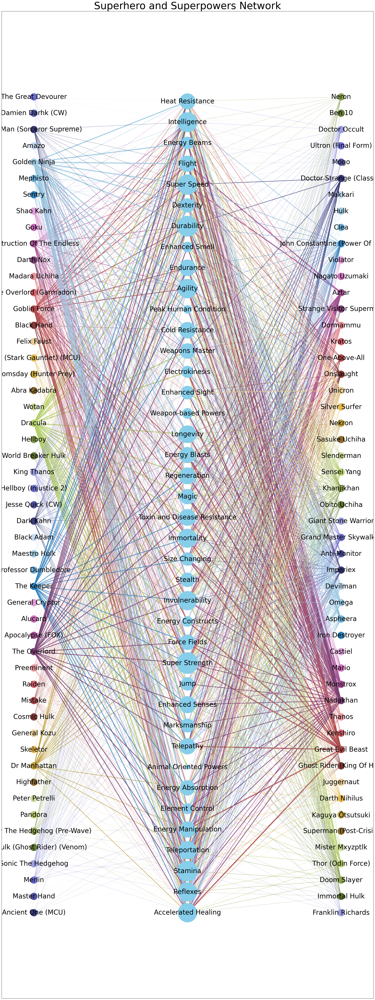

In [50]:
# Split the superhero names into two halves
name = list(name)
half_size = len(name) // 2
names_left = name[:half_size]  # First half of superhero names
names_right = name[half_size:]  # Second half of superhero names

# Custom layout function
def custom_layout(G, names_left, names_right, superpowers):
    pos = {}
    # Position the left half of superhero names on the left
    for i, node in enumerate(names_left):
        pos[node] = (-1, i * 2 / len(names_left))  # Spread vertically
    
    # Position the right half of superhero names on the right
    for i, node in enumerate(names_right):
        pos[node] = (1, i * 2 / len(names_right))  # Spread vertically

    # Position superpowers in the middle
    for i, node in enumerate(superpowers):
        pos[node] = (0, i * 2 / len(superpowers))  # Spread vertically

    return pos

# Create the custom positions
pos = custom_layout(G, names_left, names_right, superpowers)

plt.figure(figsize=(30, 80))

nx.draw_networkx_nodes(G, pos, nodelist=name, node_size=1000, node_color=list(holder_color_map.values()), label='Superhero Names')
nx.draw_networkx_nodes(G, pos, nodelist=superpowers, node_size=superpower_sizes, node_color='skyblue', label='Super Powers')
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=[G[u][v]['weight'] * 5 for u, v in G.edges()], edge_color=edge_colors, alpha=0.85)

nx.draw_networkx_labels(G, pos, font_size=30)

plt.title("Superhero and Superpowers Network", size=45)
plt.show()
%matplotlib inline

This network graph visualizes the relationships between superheroes on the left and right and their associated superpowers in the center. The dense web of connections highlights the high degree of shared abilities among superheroes, which shows us that many superpowers are commonly distributed across various characters. The complexity and interconnectivity reflect a highly interlinked network, with several superheroes sharing multiple abilities, which emphasizes the overlap within the superhero universe.

### Problem 4: 
* Part 1 Utility Matrix:
  - Create a new column in the data named herofan with the values herofanid1, herofanid2, etc.
  - Use the data to create a utility matrix with overall_score as values and the percentage of missing values in the utility matrix.
* Part 2 Recommender System with SVD:
  - Create an SVD-based Collaborative filtering recommender system to recommend movies to the user.  Calculate and report the RMSE of the recommender system.
* Part 3 Recommendations:
  - Make the top 10 recommendations for a hero fan who likes the hero name you made up (such as "Nebula Fury").

#### Part 1 Utility Matrix:
  - Create a new column in the data named herofan with the values herofanid1, herofanid2, etc.

In [51]:
problem4_df = problem1_df.copy()
problem4_df['herofan'] = ['herofanid' + str(i+1) for i in range(len(problem4_df))]
problem4_df.head(3)

,name,overall_score,history_text,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,...,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength,herofan
0,3-D Man,6.0,"Delroy Garrett, Jr. grew up to become a track ...",85,30,60,60,40,70,"['Super Speed', 'Super Strength']",...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,herofanid1
1,514A (Gotham),10.0,He was one of the many prisoners of Indian Hil...,100,20,30,50,35,100,"['Durability', 'Reflexes', 'Super Strength']",...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,herofanid2
2,A-Bomb,20.0,"Richard ""Rick"" Jones was orphaned at a young ...",80,100,80,100,100,80,"['Accelerated Healing', 'Agility', 'Berserk Mo...",...,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,herofanid3


  - Use the data to create a utility matrix with overall_score as values and the percentage of missing values in the utility matrix.

In [52]:
# Create the utility matrix
utility_matrix = problem4_df.pivot_table(index='herofan', columns='name', values='overall_score')

# Calculate the percentage of missing values
missing_percentage = utility_matrix.isna().mean().mean() * 100

print(f"Percentage of Missing Values: {missing_percentage:.2f}%")
utility_matrix

Percentage of Missing Values: 99.93%


name,3-D Man,514A (Gotham),A'dal,A-Bomb,A.I.M. Agent,A.M.A.Z.O. (CW),Aa,Aaron Cash,Aayla Secura,Abe Sapien,...,Yondu,Yondu (MCU),Yukio,Yukio (FOX),Zane,Zatanna,Zero,Zoom,Zoom (New 52),Zzzax
herofan,,,,,,,,,,,,,,,,,,,,,
herofanid1,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
herofanid10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
herofanid100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
herofanid1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
herofanid1001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
herofanid995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
herofanid996,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
herofanid997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Part 2 Recommender System with SVD:
  - Create an SVD-based Collaborative filtering recommender system to recommend movies to the user.  Calculate and report the RMSE of the recommender system.

In [53]:
from surprise import SVD, Dataset, Reader
from surprise.model_selection import cross_validate

In [54]:
# Convert the utility matrix to a long format
data_long = problem4_df[['herofan', 'name', 'overall_score']].dropna()
reader = Reader(rating_scale=(data_long['overall_score'].min(), data_long['overall_score'].max()))
surprise_data = Dataset.load_from_df(data_long[['herofan', 'name', 'overall_score']], reader)

# Perform CV to evaluate the model
svd = SVD()
cv_results = cross_validate(svd, surprise_data, measures=['RMSE'], cv=5, verbose=True)

# Calculate the average RMSE
avg_rmse = cv_results['test_rmse'].mean()
print(f"Average RMSE: {avg_rmse:.4f}")

Evaluating RMSE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    26.7707 23.4066 24.4508 12.3795 13.6225 20.1260 5.9317  
Fit time          0.03    0.02    0.02    0.02    0.02    0.02    0.00    
Test time         0.00    0.00    0.00    0.00    0.00    0.00    0.00    
Average RMSE: 20.1260


Here, I didn't spend much time trying to improve the model as I assume this is more to try out the SVD model rather than to optimize it for accuracy. Given that we made the herofan data up and each superhero only has one associated fan, the high average RMSE of 20.13 reflects these limitations. Therefore, I did not invest significant effort in improving the model, as the focus must be on understanding how SVD performs in a simplified setup.

#### Part 3 Recommendations:
  - Make the top 10 recommendations for a hero fan who likes the hero name you made up (such as "Nebula Fury").

In [55]:
inferance_data = data_long[data_long['name'] == "Monkey D. Luffy"]

# Get the herofan id
inference_herofan = inferance_data['herofan'].iloc[0]

inferance_data

,herofan,name,overall_score
266,herofanid267,Monkey D. Luffy,14.2498


In [56]:
# Generate predictions for all superhero names except "Monkey D. Luffy"
hero_names = data_long['name'].unique()
predictions = [
    (hero, svd.predict(inference_herofan, hero).est) for hero in hero_names
]

# Rank the top 10 superhero recommendations
top_10_recommendations = sorted(predictions, key=lambda x: x[1], reverse=True)[:10]

# Display the recommendations
print(f"Top 10 Recommendations for '{inference_herofan}':")
for i, (hero, score) in enumerate(top_10_recommendations, 1):
    print(f"{i}. {hero} - Predicted Score: {score:.2f}")


Top 10 Recommendations for 'herofanid267':
1. Dracula - Predicted Score: 22.23
2. Golden Ninja - Predicted Score: 19.97
3. Dormammu - Predicted Score: 19.05
4. Great Evil Beast - Predicted Score: 18.68
5. Aztar - Predicted Score: 18.44
6. Devilman - Predicted Score: 18.32
7. Sensei Yang - Predicted Score: 18.27
8. Grand Master Skywalker - Predicted Score: 18.27
9. Doctor Strange (Classic) - Predicted Score: 18.22
10. The Keeper - Predicted Score: 18.22
